# Predicting voters turnout for US election in 2016 using AutoML - Part I

## Table of Contents <a class="anchor" id="0"></a>
* [Introduction](#1) 
* [Imports](#2)
* [Connecting to ArcGIS](#3)
* [Accessing & Visualizing the datasets](#4)
* [Model Building](#9)
    * [Train-Test Data split](#70)
    * [Data Preparation](#11)
* [Fitting a Random Forest model](#5)
* [Fitting using AutoML](#6)
     * [Model output](#5f) 
* [Voters turnout prediction & Validation](#8a)
     * [Estimate model metrics for validation](#8c)
* [Conclusion](#10)
* [Data resources](#25)    

## Introduction <a class="anchor" id="1"></a>

The objective of this notebook is to demonstrate the application of AutoML on tabular data and show the improvements that can be achieved using this method, rather than conventional workflows. The newly added AutoML module in arcgis.learn is based on the MLJar library, which automates the processes of algorithm selection, data preprocessing, model training, model explainability, and final model evaluation. With these functionalities, it can perform Automatic Exploratory Data Analysis, Algorithm Selection, and Hyper-Parameters tuning to find the best model. Automatic documentation can be generated as markdown reports on the analysis with details about all models.

Once the desired improvements are obtained using AutoML, the result will be further enhanced using spatial feature engineering in the second part of the notebook.

The dataset used here is the percentage of voter turnout by county for the general election for the United States in 2016, which will be predicted using the demographic characteristics of US counties and their socioeconomic parameters.  

## Imports <a class="anchor" id="2"></a>

In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import pandas as pd

from IPython.display import Image, HTML
from sklearn.preprocessing import MinMaxScaler,RobustScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
import sklearn.metrics as metrics
from fastai.imports import *
from datetime import datetime as dt

import arcgis
from arcgis.gis import GIS
from arcgis.learn import prepare_tabulardata, AutoML, MLModel
import arcpy

## Connecting to ArcGIS <a class="anchor" id="3"></a>

In [2]:
gis = GIS("home")

## Accessing & Visualizing datasets  <a class="anchor" id="4"></a> 

Here, the 2016 election data is downloaded from the portal as a zipped shapefile, which is then unzipped and processed in the following.

<Item title:"VotersTurnoutCountyEelction2016" type:Shapefile owner:api_data_owner>
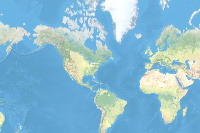

In [3]:
voter_zip = gis.content.get('650e7d6aa8fb4601a75d632a2c114425') 
voter_zip

In [4]:
import os, zipfile

In [5]:
filepath_new = voter_zip.download(file_name=voter_zip.name)
with zipfile.ZipFile(filepath_new, 'r') as zip_ref:
    zip_ref.extractall(Path(filepath_new).parent)
output_path = Path(os.path.join(os.path.splitext(filepath_new)[0]))
output_path = os.path.join(output_path,"VotersTurnoutCountyEelction2016.shp")  

In [6]:
output_path

'C:\\Users\\sup10432\\AppData\\Local\\Temp\\VotersTurnoutCountyEelction2016\\VotersTurnoutCountyEelction2016.shp'

The attribute table contains the voter turnout data by county for the entire US, which is extracted here as a pandas dataframe. The  `voter_turn` field in the dataframe contains the voter turnout data in percentages for each county for the 2016 election. This will be used as the dependent variable and will be predicted using the various demographic and socioeconomic variables for each county.

In [7]:
# getting the attribute table from the shapefile which will be used for building the model
sdf_main = pd.DataFrame.spatial.from_featureclass(output_path)
sdf_main.head()

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,NNeighbors,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE
0,0,1,1,01001,Autauga,Alabama,0.613738,38.6,25553.0,4.96,...,44,0.211580,0.154568,0,0,2.496745e+05,2.208598e+09,133735.292502,0,"{""rings"": [[[-9619465, 3856529.0001000017], [-..."
1,1,1,2,01003,Baldwin,Alabama,0.627364,42.9,31429.0,4.64,...,22,0.358894,0.057952,0,0,1.642763e+06,5.671096e+09,241925.196426,3,"{""rings"": [[[-9746859, 3539643.0001000017], [-..."
2,2,1,3,01005,Barbour,Alabama,0.513816,40.2,16876.0,3.49,...,62,-0.868722,-0.498354,1,1,3.202971e+05,3.257816e+09,0.000000,0,"{""rings"": [[[-9468394, 3771591.0001000017], [-..."
3,3,1,4,01007,Bibb,Alabama,0.501364,39.3,19360.0,3.64,...,43,-1.003341,0.286440,0,0,2.279101e+05,2.311955e+09,170214.485759,7,"{""rings"": [[[-9692114, 3928124.0001000017], [-..."
4,4,1,5,01009,Blount,Alabama,0.603064,40.9,21785.0,3.86,...,51,0.096177,-0.336198,0,1,2.918753e+05,2.456919e+09,21128.568784,7,"{""rings"": [[[-9623907, 4063676.0001000017], [-..."


In [8]:
sdf_main.shape

(3112, 97)

The data is visualized here by mapping the voter turnout field into five classes. It can be seen that there is a belt running along the southeastern part of the country, which represents comparatively lower voter turnout of less than 55%.


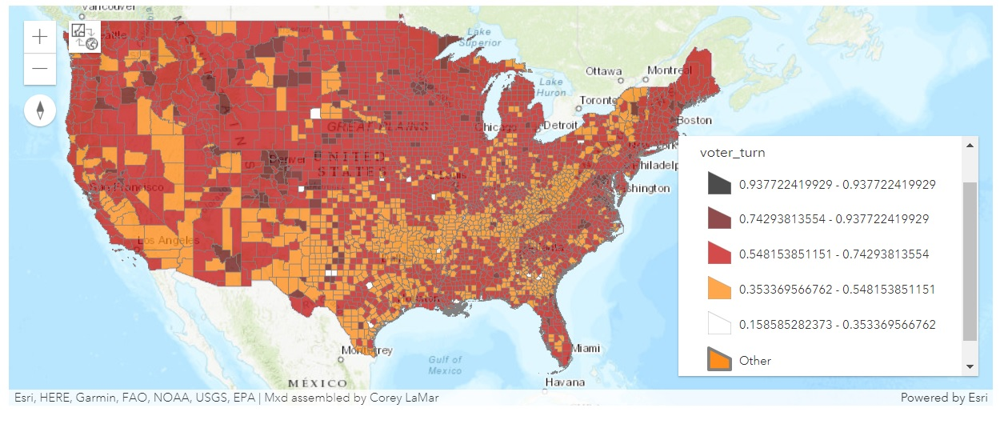

In [9]:
# Visualizing voters turnout in percentages by county
m1= GIS().map('United States', zoomlevel=4)
sdf_main.spatial.plot(map_widget = m1,renderer_type='c', col='voter_turn',  line_width=0.2, method='esriClassifyNaturalBreaks', class_count=5, cmap='gist_heat_r',alpha=0.7)
m1.legend=True
m1

## Model Building <a class="anchor" id="9"></a>

Once the dataset is divided into the training and test dataset, the training data is ready to be used for modeling.

###  Train-Test Data split<a class="anchor" id="70"></a>

The dataset above has 3112 samples, each representing US counties and their voter turnout, along with related variables. Next, it will be split into training and test datasets, in a 90 to 10 ratio for training and validation respectively.

In [10]:
# Splitting data with a test size of 10% for validation 
test_size = 0.10
sdf_train_base, sdf_test_base = train_test_split(sdf_main, test_size = test_size, random_state=42)

In [11]:
sdf_train_base.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,NNeighbors,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE
1798,1798,1,1799,36001,Albany,New York,0.587546,40.1,38227.0,5.00,...,31,-0.071597,-0.099099,0,0,225997.958853,2.550720e+09,150330.823825,589,"{""rings"": [[[-8201660, 5279044.000100002], [-8..."
1003,1003,1,1004,21081,Grant,Kentucky,0.541740,36.9,20490.0,3.59,...,87,-0.566824,-0.125723,0,0,148480.244249,1.108905e+09,84976.878589,339,"{""rings"": [[[-9419382, 4693378.000100002], [-9..."


In [12]:
# checking the columns in the dataset
sdf_main.columns

Index(['FID', 'Join_Count', 'TARGET_FID', 'FIPS', 'county', 'state',
       'voter_turn', 'gender_med', 'householdi', 'electronic', 'raceandhis',
       'voter_laws', 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1', 'randomized',
       

### Data Preparation <a class="anchor" id="11"></a>

First, a list of explanatory variables is chosen that consists of the feature data that will be used for predicting voter turnout. By default, it will receive continuous variables, and in the case of categorical variables, the **True** value is passed inside a tuple, along with the variable. Here `county`, `state` and `voter_laws` are categorical variables.

In [13]:
# listing explanatory variables
X =[('county',True), ('state',True),'gender_med', 'householdi', 'electronic', 'raceandhis',
       ('voter_laws',True), 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1',
        'City10Dist','City9Dist', 'City8Dist', 'City7Dist','City6Dist',
        'City5Dist']

The preprocessor uses a scaler to transform the explanatory variables, which is defined as follows:

In [14]:
# defining the preprocessors for scaling data
preprocessors = [('county', 'state','gender_med', 'householdi', 'electronic', 'raceandhis',
       'voter_laws', 'educationa', 'educatio_1', 'educatio_2', 'educatio_3',
       'maritalsta', 'F5yearincr', 'F5yearin_1', 'F5yearin_2', 'F5yearin_3',
       'F5yearin_4', 'F5yearin_5', 'F5yearin_6', 'language_a', 'hispanicor',
       'hispanic_1', 'raceandh_1', 'atrisk_avg', 'disposable', 'disposab_1',
       'disposab_2', 'disposab_3', 'disposab_4', 'disposab_5', 'disposab_6',
       'disposab_7', 'disposab_8', 'disposab_9', 'disposa_10', 'househol_1',
       'househol_2', 'househol_3', 'househol_4', 'househol_5', 'househol_6',
       'househol_7', 'househol_8', 'househol_9', 'language_1', 'language_2',
       'households', 'househo_10', 'educatio_4', 'educatio_5', 'educatio_6',
       'educatio_7', 'psychograp', 'psychogr_1', 'financial_', 'financial1',
       'financia_1', 'miscellane', 'state_vote', 'state_vo_1',
        'City10Dist', 'City9Dist',
       'City8Dist', 'City7Dist','City6Dist',
       'City5Dist', MinMaxScaler())]

Finally, using the explanatory variables list above, the preprocessors and the prediction variable of voter turnout, the prepare_tabulardata prepares the data to be fed into the model.

In [15]:
# preparing data for the model
data_base_model = prepare_tabulardata(sdf_train_base,
                           variable_predict='voter_turn',
                           explanatory_variables=X, 
                           preprocessors=preprocessors)

C:\Users\sup10432\AppData\Local\ESRI\conda\envs\pro_automl_26Octb\lib\site-packages\arcgis\learn\_utils\tabular_data.py:1035: UserWarning:

Column county has more than 20 unique value. Sure this is categorical?

C:\Users\sup10432\AppData\Local\ESRI\conda\envs\pro_automl_26Octb\lib\site-packages\arcgis\learn\_utils\tabular_data.py:1035: UserWarning:

Column state has more than 20 unique value. Sure this is categorical?



## Fitting a random forest model  <a class="anchor" id="5"></a> 

First a random forest model is fitted to the data, and its performance is measured.

### Model Initialization <a class="anchor" id="12"></a>

The MLModel is initialized with the Random Forest model from Sklearn, along with its model parameters.

In [16]:
# defining the model along with the parameters 
model = MLModel(data_base_model, 'sklearn.ensemble.RandomForestRegressor', n_estimators=500, random_state=43)

In [17]:
model.fit()

In [18]:
model.score()

0.6388235590727049

In [19]:
# validating trained model on test dataset
voter_county_mlmodel_predicted = model.predict(sdf_test_base, prediction_type='dataframe')

In [20]:
voter_county_mlmodel_predicted.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE,prediction_results
557,557,1,558,16073,Owyhee,Idaho,0.529332,37.1,19701.0,3.66,...,-0.700966,-0.496409,0,0,942771.682539,3.679323e+10,484820.245797,672,"{""rings"": [[[-12970046, 5356298.000100002], [-...",0.533127
416,416,1,417,13119,Franklin,Georgia,0.506977,42.2,18965.0,3.44,...,-0.942663,-0.089913,0,0,152970.676619,1.015526e+09,129997.253626,591,"{""rings"": [[[-9245266, 4095289.0001000017], [-...",0.533401


In [21]:
# calculating validation model score
r_square_voter_county_mlmodel_Test = metrics.r2_score(voter_county_mlmodel_predicted['voter_turn'], voter_county_mlmodel_predicted['prediction_results']) 
print('r_square_voter_county_mlmodel_Test: ', round(r_square_voter_county_mlmodel_Test,2))

r_square_voter_county_mlmodel_Test:  0.71


The validation r square for the random forest model is satisfactory, and now AutoML will be used to improve it.

## Fitting Using AutoML  <a class="anchor" id="6"></a> 

The same data obtained using the prepare_taular data function is next used as input for the AutoML model. Out of the various AutoML modes available, here the compete mode is used which uses 10-fold CV (Cross-Validation) and the Decision Tree, Random Forest, Extra Trees, XGBoost, Neural Network, Nearest Neighbors, Ensemble, and Stacking models to achieve higher machine learning accuracy.

In [22]:
# initializing AutoML model with the Compete mode 
AutoML_voters_county_base_compete = AutoML(data_base_model, eval_metric='r2', mode='Compete', n_jobs=1)

In the above initialization, the `Compete` mode is selected out of the three available modes, `Compete`, `Perform`, and `Compete`. While `Compete` is the best performing mode, it also consumes a significant amount of resources and time, and it is only recommended for instances where the best results are necessary. In other cases, the Explain or Perform modes can be used for a faster basic fit.

In [23]:
# training the AutoML model
AutoML_voters_county_base_compete.fit()

Neural Network algorithm was disabled because it doesn't support n_jobs parameter.
AutoML directory: AutoML_1
The task is regression with evaluation metric r2
AutoML will use algorithms: ['Linear', 'Decision Tree', 'Random Forest', 'Extra Trees', 'LightGBM', 'Xgboost']
AutoML will stack models
AutoML will ensemble availabe models
AutoML steps: ['adjust_validation', 'simple_algorithms', 'default_algorithms', 'not_so_random', 'kmeans_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'boost_on_errors', 'ensemble', 'stack', 'ensemble_stacked']
* Step adjust_validation will try to check up to 1 model
1_DecisionTree r2 0.278123 trained in 0.82 seconds
Adjust validation. Remove: 1_DecisionTree
Validation strategy: 10-fold CV Shuffle
* Step simple_algorithms will try to check up to 4 models
1_DecisionTree r2 0.403535 trained in 6.96 seconds
2_DecisionTree r2 0.458642 trained in 6.55 seconds
3_DecisionTree r2 0.458642 trained in 6.7 seconds
4_Linear

AutoML significantly improves the fit when compared to the standalone random forest model, and the validation r square jumps to a new high. Now, the previous visualization of the data reveals the presence of a spatial pattern in the data, and in the second part of the notebook, this spatial pattern is estimated and included as a spatial feature to further improve the model.

In [24]:
# train score of the model
AutoML_voters_county_base_compete.score()

0.9560210208116269

### Model output  <a class="anchor" id="5f"></a>

In [25]:
# The output diagnostics can also be printed in a report form
AutoML_voters_county_base_compete.report()

C:\Users\sup10432\AppData\Local\ESRI\conda\envs\pro_automl_26Octb\lib\site-packages\arcgis\learn\models\_auto_ml.py:284: UserWarning:

In case the report html is not rendered appropriately in the notebook, the same can be found in the path AutoML_1\README.html



Best model,name,model_type,metric_type,metric_value,train_time
,1_DecisionTree,Decision Tree,r2,0.403535,7.36
,2_DecisionTree,Decision Tree,r2,0.458642,6.95
,3_DecisionTree,Decision Tree,r2,0.458642,7.1
,4_Linear,Linear,r2,0.661466,7.4
,5_Default_LightGBM,LightGBM,r2,0.772467,39.76
,6_Default_Xgboost,Xgboost,r2,0.76779,131.51
,7_Default_RandomForest,Random Forest,r2,0.587323,58.82
,8_Default_ExtraTrees,Extra Trees,r2,0.532677,17.57
,18_LightGBM,LightGBM,r2,0.784405,25.94
,9_Xgboost,Xgboost,r2,0.759364,138.21


## Voters turnout prediction & Validation <a class="anchor" id="8a"></a>

In [26]:
# validating trained model on test dataset
voter_county_automl_predicted = AutoML_voters_county_base_compete.predict(sdf_test_base, prediction_type='dataframe')

In [27]:
voter_county_automl_predicted.head(2)

,FID,Join_Count,TARGET_FID,FIPS,county,state,voter_turn,gender_med,householdi,electronic,...,ZTransform,SpatialLag,LMi_hi_sig,LMi_normal,Shape_Le_1,Shape_Ar_1,LMiHiDist,NEAR_FID,SHAPE,prediction_results
557,557,1,558,16073,Owyhee,Idaho,0.529332,37.1,19701.0,3.66,...,-0.700966,-0.496409,0,0,942771.682539,3.679323e+10,484820.245797,672,"{""rings"": [[[-12970046, 5356298.000100002], [-...",0.519827
416,416,1,417,13119,Franklin,Georgia,0.506977,42.2,18965.0,3.44,...,-0.942663,-0.089913,0,0,152970.676619,1.015526e+09,129997.253626,591,"{""rings"": [[[-9245266, 4095289.0001000017], [-...",0.525310


### Estimate model metrics for validation <a class="anchor" id="8c"></a>

In [28]:
import sklearn.metrics as metrics

In [29]:
r_square_voter_county_automl_Test = metrics.r2_score(voter_county_automl_predicted['voter_turn'], voter_county_automl_predicted['prediction_results']) 
print('r_square_voter_county_automl_Test: ', round(r_square_voter_county_automl_Test,2))

r_square_voter_county_automl_Test:  0.78


## Conclusion<a class="anchor" id="10"></a>

In this notebook, AutoML was applied to a regression dataset and was able to achieve significant improvement over traditional methods of modeling. Data visualization also showed the presence of spatial autocorrelation in voter turnout distributed across the country. The fit of the model can be further improved by extracting this spatial pattern in the data, and this process is elaborated on in part two of this notebook.

### Data resources <a class="anchor" id="25"></a>

| Reference | Source | Link |
| -| - |-|
|Voters turnout by county for 2016 US general election|Esri| https://www.arcgis.com/home/item.html?id=650e7d6aa8fb4601a75d632a2c114425|